In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from fastai import *
from fastai.vision import *
from skimage.draw import polygon
import os
import xml.etree.ElementTree as ET
import numpy as np
from skimage.io import imread

## Download and unzip data

In [3]:
path = Path.cwd(); path

PosixPath('/home/jupyter/RASM2018')

In [32]:
(path / 'train').mkdir(parents=True, exist_ok=True)
(path / 'valid').mkdir(parents=True, exist_ok=True)

In [33]:
path.ls()

[PosixPath('/home/jupyter/RASM2018/requirements.txt'),
 PosixPath('/home/jupyter/RASM2018/.gitattributes'),
 PosixPath('/home/jupyter/RASM2018/README.md'),
 PosixPath('/home/jupyter/RASM2018/valid'),
 PosixPath('/home/jupyter/RASM2018/.git'),
 PosixPath('/home/jupyter/RASM2018/Arabic Scientific Manuscripts Segmentation.ipynb'),
 PosixPath('/home/jupyter/RASM2018/train'),
 PosixPath('/home/jupyter/RASM2018/.gitignore'),
 PosixPath('/home/jupyter/RASM2018/RASM2018_Example_Set.zip'),
 PosixPath('/home/jupyter/RASM2018/.ipynb_checkpoints'),
 PosixPath('/home/jupyter/RASM2018/RASM2018_Evaluation_Set_Images 2.zip'),
 PosixPath('/home/jupyter/RASM2018/code'),
 PosixPath('/home/jupyter/RASM2018/RASM2018_Evaluation_Set_Images 1.zip'),
 PosixPath('/home/jupyter/RASM2018/Training_Data')]

In [8]:
# Download training set
! wget "https://www.dropbox.com/s/j4348fx4k7ow4zh/RASM2018_Example_Set.zip"

--2018-11-10 18:32:39--  https://www.dropbox.com/s/j4348fx4k7ow4zh/RASM2018_Example_Set.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.8.1, 2620:100:601b:1::a27d:801
Connecting to www.dropbox.com (www.dropbox.com)|162.125.8.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/j4348fx4k7ow4zh/RASM2018_Example_Set.zip [following]
--2018-11-10 18:32:39--  https://www.dropbox.com/s/raw/j4348fx4k7ow4zh/RASM2018_Example_Set.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc0d50021e3ff2a12048294330ab.dl.dropboxusercontent.com/cd/0/inline/AVSBhySAidOr08qbUD_1VfFwzqs6up-XTk3XK0oylGODXgLZXe0uh3CUUrrKwxAFKusYAgGXyCELrKNOH_tZOSfK9bqwY_fbwN9scAfnGpyoIB5rWFH21NKyXjyEUBfgzCnljfLhrEztp_w7c4VRSV25P43rYb_aSmemu4aGF92TXv1WiRMsXPate27H6JM9MEs/file [following]
--2018-11-10 18:32:39--  https://uc0d50021e3ff2a12048294330ab.dl.dropboxusercontent.com/cd/0/inline/AVSBhySAidOr08q

In [34]:
! unzip {path / 'RASM2018_Example_Set.zip'} -d {path / 'train'}

Archive:  /home/jupyter/RASM2018/RASM2018_Example_Set.zip
  inflating: /home/jupyter/RASM2018/train/Add MS 23494_0031.jp2  
  inflating: /home/jupyter/RASM2018/train/Add MS 23494_0031.tif  
  inflating: /home/jupyter/RASM2018/train/Add MS 23494_0031.xml  
  inflating: /home/jupyter/RASM2018/train/Add MS 7474_0013.tif  
  inflating: /home/jupyter/RASM2018/train/Add MS 7474_0013.xml  
  inflating: /home/jupyter/RASM2018/train/Add MS 7474_0042.jp2  
 extracting: /home/jupyter/RASM2018/train/Add MS 7474_0042.tif  
  inflating: /home/jupyter/RASM2018/train/Add MS 7474_0042.xml  
  inflating: /home/jupyter/RASM2018/train/Add MS 7474_0043.jp2  
  inflating: /home/jupyter/RASM2018/train/Add MS 7474_0043.tif  
  inflating: /home/jupyter/RASM2018/train/Add MS 7474_0043.xml  
  inflating: /home/jupyter/RASM2018/train/Delhi Arabic 1901_0036.jp2  
  inflating: /home/jupyter/RASM2018/train/Delhi Arabic 1901_0036.tif  
  inflating: /home/jupyter/RASM2018/train/Delhi Arabic 1901_0036.xml  
  inflating

In [11]:
# Download test set pt 1
! wget "https://www.dropbox.com/s/wwj5cenwr6z01it/RASM2018_Evaluation_Set_Images%201.zip"

--2018-11-10 18:34:10--  https://www.dropbox.com/s/wwj5cenwr6z01it/RASM2018_Evaluation_Set_Images%201.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.8.1, 2620:100:601b:1::a27d:801
Connecting to www.dropbox.com (www.dropbox.com)|162.125.8.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/wwj5cenwr6z01it/RASM2018_Evaluation_Set_Images%201.zip [following]
--2018-11-10 18:34:11--  https://www.dropbox.com/s/raw/wwj5cenwr6z01it/RASM2018_Evaluation_Set_Images%201.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc9a5dcac78f050f315b229430be.dl.dropboxusercontent.com/cd/0/inline/AVSf9R2f2eNmC7eP37fky_uAT7lq77z67HfFeaxD7x6jyfkRmhjMFywSGTJh_RkkQ-9M18RuCf_RW6CDfefTP2tHXXgKi0MczzN289LNT6cUtNqtUys3GfJ7UgYw1em_XK-xc0CkYKkRZ9pHXXLeTMv7oQI8jG2heIm2_O9zVsdUvhHvQ8aW4M4IGvPpo-80irc/file [following]
--2018-11-10 18:34:11--  https://uc9a5dcac78f050f315b229430be.dl.dropboxu

In [35]:
! unzip {path / 'RASM2018_Evaluation_Set_Images\ 1.zip'} -d {path / 'valid'}

Archive:  /home/jupyter/RASM2018/RASM2018_Evaluation_Set_Images 1.zip
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0027.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0028.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0029.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0030.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0032.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0033.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0038.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0039.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0044.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0045.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0046.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 23494_0047.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 7474_0044.tif  
  inflating: /home/jupyter/RASM2018/valid/Add MS 7474_0045.tif  
  inflat

In [13]:
# Download test set pt 2
! wget "https://www.dropbox.com/s/yuqh6tk5sd5kdfd/RASM2018_Evaluation_Set_Images%202.zip"

--2018-11-10 18:37:18--  https://www.dropbox.com/s/yuqh6tk5sd5kdfd/RASM2018_Evaluation_Set_Images%202.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.8.1, 2620:100:601b:1::a27d:801
Connecting to www.dropbox.com (www.dropbox.com)|162.125.8.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/yuqh6tk5sd5kdfd/RASM2018_Evaluation_Set_Images%202.zip [following]
--2018-11-10 18:37:18--  https://www.dropbox.com/s/raw/yuqh6tk5sd5kdfd/RASM2018_Evaluation_Set_Images%202.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc7376f901d1c3b1a90b6246d744.dl.dropboxusercontent.com/cd/0/inline/AVR7tsIWiDd4rGo2K3Cw46x0xfToGdRKFjcZoYa0DDIE0cMV4f7luGSmoRqG3mO_3iP_dRtwOL2sxsksKwEHyBuqLEwnOo2hcGbaKoVscxTdI6EwhjlfVUD-DlBYNVP9B2HJUp_GFjYdEmYF7Mp68cNP2oLdUnher5W0qPcJqZJVt-qNaLbX6ya6MYOL8zpKryE/file [following]
--2018-11-10 18:37:18--  https://uc7376f901d1c3b1a90b6246d744.dl.dropboxu

In [36]:
! unzip {path / 'RASM2018_Evaluation_Set_Images\ 2.zip'} -d {path / 'valid'}

Archive:  /home/jupyter/RASM2018/RASM2018_Evaluation_Set_Images 2.zip
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0044.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0045.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0048.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0049.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0054.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0055.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0162.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0164.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0166.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0167.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 13006_0173.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 14791_0011.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 14791_0012.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 14791_0013.tif  
  inflating: /home/jupyter/RASM2018/valid/Or 14791_0014.tif  


In [37]:
path.ls()

[PosixPath('/home/jupyter/RASM2018/requirements.txt'),
 PosixPath('/home/jupyter/RASM2018/.gitattributes'),
 PosixPath('/home/jupyter/RASM2018/README.md'),
 PosixPath('/home/jupyter/RASM2018/valid'),
 PosixPath('/home/jupyter/RASM2018/.git'),
 PosixPath('/home/jupyter/RASM2018/Arabic Scientific Manuscripts Segmentation.ipynb'),
 PosixPath('/home/jupyter/RASM2018/train'),
 PosixPath('/home/jupyter/RASM2018/.gitignore'),
 PosixPath('/home/jupyter/RASM2018/RASM2018_Example_Set.zip'),
 PosixPath('/home/jupyter/RASM2018/.ipynb_checkpoints'),
 PosixPath('/home/jupyter/RASM2018/RASM2018_Evaluation_Set_Images 2.zip'),
 PosixPath('/home/jupyter/RASM2018/code'),
 PosixPath('/home/jupyter/RASM2018/RASM2018_Evaluation_Set_Images 1.zip'),
 PosixPath('/home/jupyter/RASM2018/Training_Data')]

## Produce masks from xml ground truth and save as images

In [4]:
# Number of images with ground truth for training
train_xml_files = [file for file in (path / 'train').ls() if file.suffix == '.xml']; len(train_xml_files)

10

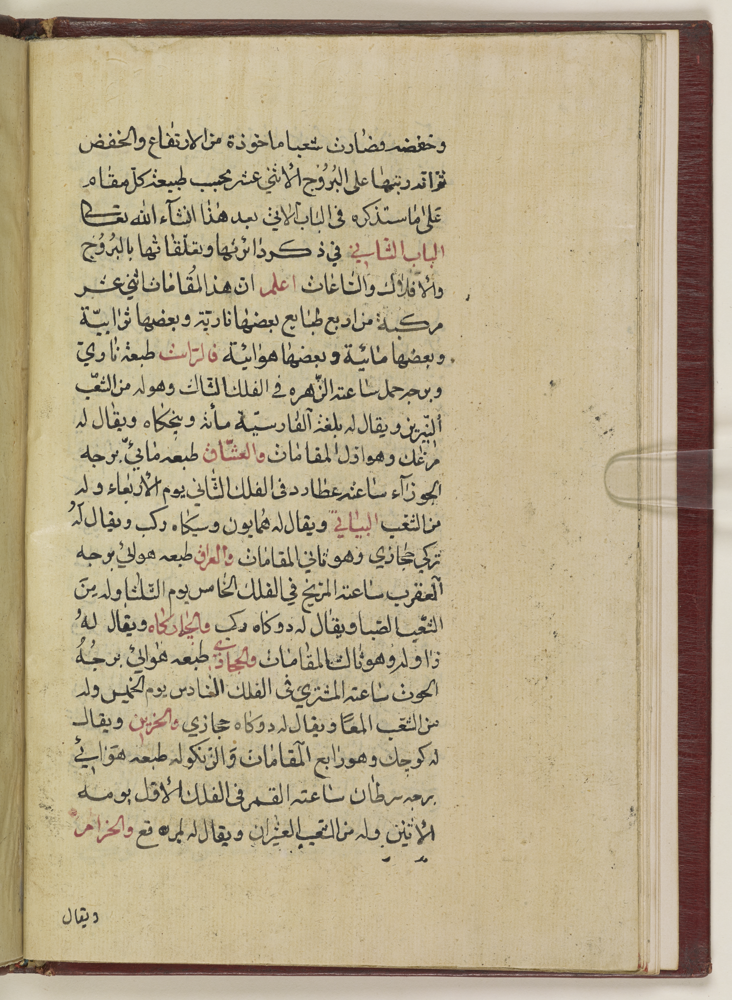

In [6]:
img_f = (path / 'train' / 'Add MS 23494_0031.tif')
img = open_image(img_f)
img

In [12]:
SCHEMA = '{http://schema.primaresearch.org/PAGE/gts/pagecontent/2017-07-15}'


def parse_coords(points):
    return np.array([tuple(int(p) for p in point.split(',')) for point in points.split()])


def load_xml_as_dict(path_to_file):
    tree = ET.parse(path_to_file)
    root = tree.getroot()
    metadata = root.find(f'{SCHEMA}Metadata')
    page = root.find(f'{SCHEMA}Page')
    image_info = page.attrib
    text_region_list = page.findall(f'{SCHEMA}TextRegion')
    text_region_data = []
    for text_region in text_region_list:
        text_region_id = text_region.attrib.get('id')
        text_region_type = text_region.attrib.get('type', 'graphic')
        text_region_coords = text_region.find(f'{SCHEMA}Coords').attrib.get('points')
        text_line_list = text_region.findall(f'{SCHEMA}TextLine')
        text_line_data = []
        for text_line in text_line_list:
            text_line_id = text_line.attrib['id']
            text_line_coords = text_line.find(f'{SCHEMA}Coords').attrib.get('points')
            text_line_text = text_line.find(f'{SCHEMA}TextEquiv')[0].text
            text_line_data.append({
                'id': text_line_id,
                'points': parse_coords(text_line_coords),
                'text': text_line_text
            })

        text_region_data.append({
            'id': text_region_id,
            'type': text_region_type,
            'points': parse_coords(text_region_coords),
            'lines': text_line_data
        })
    return image_info, text_region_data

class_labels = [
    'page',
    'paragraph',
    'marginalia',
    'caption',
    'graphic',
    'page-number'
]

In [10]:
from scipy.misc import imsave

for xml_file in train_xml_files:
    print(xml_file)
    image_info, xml_as_dict = load_xml_as_dict(xml_file)
    image_file_name = image_info['imageFilename'].split('.')[0]
    print(image_file_name)
    im_height = int(image_info['imageHeight'])
    im_width = int(image_info['imageWidth'])
    labels = np.zeros((im_height, im_width), dtype=np.uint8)
    for text_region in xml_as_dict:
        points = text_region['points']
        region_type = text_region['type']
        rr, cc = polygon(points[:, 1], points[:, 0])
        labels[rr, cc] = class_labels.index(region_type) # Fix label issue for graphics....
    imsave((path / 'train_labels'/ f'{image_file_name}_labels.png'), labels)

/home/jupyter/RASM2018/train/Add MS 7474_0043.xml
Add MS 7474_0043


/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:16: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  app.launch_new_instance()


/home/jupyter/RASM2018/train/Or 13006_0169.xml
Or 13006_0169
/home/jupyter/RASM2018/train/Add MS 7474_0013.xml
Add MS 7474_0013
/home/jupyter/RASM2018/train/Add MS 23494_0031.xml
Add MS 23494_0031
/home/jupyter/RASM2018/train/Or 5593_0024.xml
Or 5593_0024
/home/jupyter/RASM2018/train/Or 13006_0172.xml
Or 13006_0172
/home/jupyter/RASM2018/train/Or 9202_0052.xml
Or 9202_0052
/home/jupyter/RASM2018/train/Or 5593_0083.xml
Or 5593_0083
/home/jupyter/RASM2018/train/Add MS 7474_0042.xml
Add MS 7474_0042
/home/jupyter/RASM2018/train/Delhi Arabic 1901_0036.xml
Delhi Arabic 1901_0036


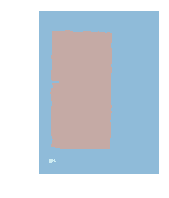

In [7]:
mask = open_mask(get_y_fn(img_f))
mask.show()

## Create dataset

In [43]:
src_size = np.array(mask.shape[1:])
size = src_size // 12
bs = 1; size

array([431, 316])

In [44]:
get_y_fn = lambda x: path / 'train_labels' / f'{x.stem}_labels.png'

In [45]:
src = (ImageFileList.from_folder(path / 'train')
       .label_from_func(get_y_fn)
       .random_split_by_pct()
      )
data = (src.datasets(SegmentationDataset, classes=class_labels)
        .transform(get_transforms(do_flip=False, max_zoom=1.4), size=size, tfm_y=True)
        .databunch(bs=bs)
        .normalize(imagenet_stats))

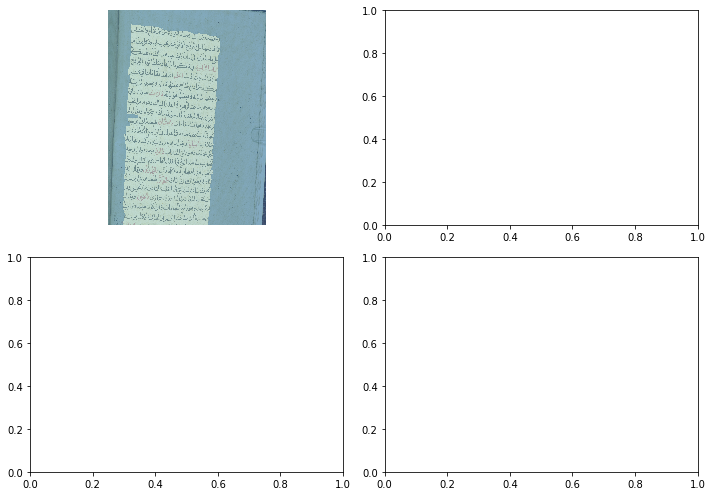

In [47]:
data.show_batch(2, figsize=(10,7))

## Training

In [38]:
learn = Learner.create_unet(data, models.resnet34, metrics=accuracy)

In [39]:
lr_find(learn)
learn.recorder.plot()

epoch,train_loss,valid_loss,accuracy


LR Finder complete, type {learner_name}.recorder.plot() to see the graph.


KeyError: 'train'

In [ ]:
lr=1e-2

In [ ]:
learn.fit_one_cycle(10, slice(lr))

In [ ]:
learn.save('stage-1')